In this situation we will import the needed libraries to get data from ESPN

In [23]:
import pandas as pd
import requests
from bs4 import BeautifulSoup, element
import time

Define List of Players (2015)

In [57]:
base_url = "https://www.pro-football-reference.com/players"
list_of_players = ["Jameis Winston", "Marcus Mariota", "Garrett Grayson", "Sean Mannion", "Bryce Petty", "Brett Hundley", "Trevor Siemian"]
list_of_players_urls = ["https://www.pro-football-reference.com/players/W/WinsJa00.htm","https://www.pro-football-reference.com/players/M/MariMa01.htm", "https://www.pro-football-reference.com/players/M/MannSe00.htm", "https://www.pro-football-reference.com/players/P/PettBr01.htm", "https://www.pro-football-reference.com/players/H/HundBr00.htm", "https://www.pro-football-reference.com/players/S/SiemTr00.htm"]

list_of_years = ["2015", "2016", "2017", "2018", "2019", "2020", "2021", "2022", "2023"]

First Let us Attempt to send in a request to Football Reference by accessing the specific draft year. Let us print the response to make sure that the request succeded

In [74]:
headers = {'User-Agent': 'Mozilla/6.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/111.0.0.0 Safari/537.36'}
obj = {}
def get_game_log_data(link, name):
    year_url = f"{base_url}{link}"
    api_response = requests.get(year_url, headers=headers)
    local_soup = BeautifulSoup(api_response.text, 'html.parser')
    
    for num in range(1,18):
        stats_for_week = local_soup.find("tr", id=f"stats.{num}")
        if stats_for_week:
            
            ## Wins
            game_result = stats_for_week.find("td", {"data-stat": "game_result"})
            win_or_loss = ""
            if game_result:
                win_or_loss = game_result.get_text()[0]
            
            ## Pass Completions 
            pass_cmp = stats_for_week.find("td", {"data-stat": "pass_cmp"})
            pass_cmp_num = 0
            if pass_cmp:
                pass_cmp_num = int(pass_cmp.get_text())
                
            ## Pass Attempts
            pass_att = stats_for_week.find("td", {"data-stat": "pass_att"})
            pass_att_num = 0
            if pass_att:
                pass_att_num = int(pass_att.get_text())
                
            ## Pass Yards
            pass_yds = stats_for_week.find("td", {"data-stat": "pass_yds"})
            pass_yds_num = 0
            if pass_yds:
                pass_yds_num = int(pass_yds.get_text())
            
            ## Passing Touchdowns
            pass_td = stats_for_week.find("td", {"data-stat": "pass_td"})
            pass_td_num = 0
            if pass_td:
                pass_td_num = int(pass_td.get_text())
            
            ## Passing Interceptions
            pass_int = stats_for_week.find("td", {"data-stat": "pass_int"})
            pass_int_num = 0
            if pass_int:
                pass_int_num = int(pass_int.get_text())
            
            ## Passer Rating
            pass_rtg = stats_for_week.find("td", {"data-stat": "pass_rating"})
            pass_rtg_num = 0
            if pass_rtg:
                pass_rtg_num = int(pass_rtg.get_text())
            
            ## Rushing Yards
            rush_yds = stats_for_week.find("td", {"data-stat": "rush_yds"})
            rush_yds_num = 0
            if rush_yds:
                rush_yds_num = int(rush_yds.get_text())
            
            
    with open('output.html', 'w', encoding='utf-8') as file:
        file.write(local_soup.find("tr", id='stats.1').prettify())
    
for player_url, player_name in zip(list_of_players_urls, list_of_players):
    response = requests.get(url=player_url, headers=headers) ## Get Data for each player
    soup = BeautifulSoup(response.text, 'html.parser')
    game_logs_links = list(soup.find_all("ul", class_="")[1].find_all("a"))
    years_game_log_links = []
    for i, game_logs_link in enumerate(game_logs_links):
        if game_logs_link.get_text() in list_of_years:
            years_game_log_links.append(game_logs_link['href'])
    
    for year in years_game_log_links:
        get_game_log_data(year, player_name)
        time.sleep(2)
        break ## For testing purposes right now 
    break


L
W
L
L
W
L
W
L
W
W
L
W
L
L
L
L


Next Let us attempt to parse data using BeautifulSoup

<!DOCTYPE html>
<html class="no-js" data-root="/home/pfr/build" data-version="klecko-" lang="en">
 <head>
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <link href="https://cdn.ssref.net/req/202410171" rel="dns-prefetch"/>
   <script>
    /* https://docs.osano.com/hc/en-us/articles/22469433444372-Google-Consent-Mode-v2  */
  window.dataLayer = window.dataLayer ||[];
      function gtag(){dataLayer.push(arguments);}
      gtag('consent','default',{
        'ad_storage':'denied',
        'analytics_storage':'denied',
        'ad_user_data':'denied',
        'ad_personalization':'denied',
        'personalization_storage':'denied',
        'functionality_storage':'granted',
        'security_storage':'granted',
        'wait_for_update': 500
      });
      gtag("set", "ads_data_redaction", true);
   </script>
   <script src="https://cmp.osano.com/16CGnCU8UtNh

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



<!DOCTYPE html>
<html class="no-js" data-root="/home/pfr/build" data-version="klecko-" lang="en">
 <head>
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <link href="https://cdn.ssref.net/req/202410171" rel="dns-prefetch"/>
   <script>
    /* https://docs.osano.com/hc/en-us/articles/22469433444372-Google-Consent-Mode-v2  */
  window.dataLayer = window.dataLayer ||[];
      function gtag(){dataLayer.push(arguments);}
      gtag('consent','default',{
        'ad_storage':'denied',
        'analytics_storage':'denied',
        'ad_user_data':'denied',
        'ad_personalization':'denied',
        'personalization_storage':'denied',
        'functionality_storage':'granted',
        'security_storage':'granted',
        'wait_for_update': 500
      });
      gtag("set", "ads_data_redaction", true);
   </script>
   <script src="https://cmp.osano.com/16CGnCU8UtNh

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



<!DOCTYPE html>
<html class="no-js" data-root="" data-version="klecko-" lang="en">
 <head id="suppress_all_ads">
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <title>
    Rate Limited Request (429 error) | Sports-Reference.com
   </title>
   <link href="https://www.sports-reference.com/429.html" rel="canonical"/>
   <!-- CSS start -->
   <style>
    body,html{color:#000;font:14px/1.25 Helvetica Neue,helvetica,arial,sans-serif;margin:0;padding:0}html:not(.backstop){scroll-behavior:smooth}html:not(.backstop) div,html:not(.backstop) span{scroll-snap-margin:2.5em 0 0 0;scroll-margin:2.5em 0 0 0}body{-webkit-text-size-adjust:none;-moz-text-size-adjust:none;-ms-text-size-adjust:none;background:#c9cbcd;position:relative;z-index:0}a img{border:0}li,ol,ul{list-style-type:none;margin:0;padding:0}table td,table th{border:0}iframe{max-width:100%}code{background:#eee}a
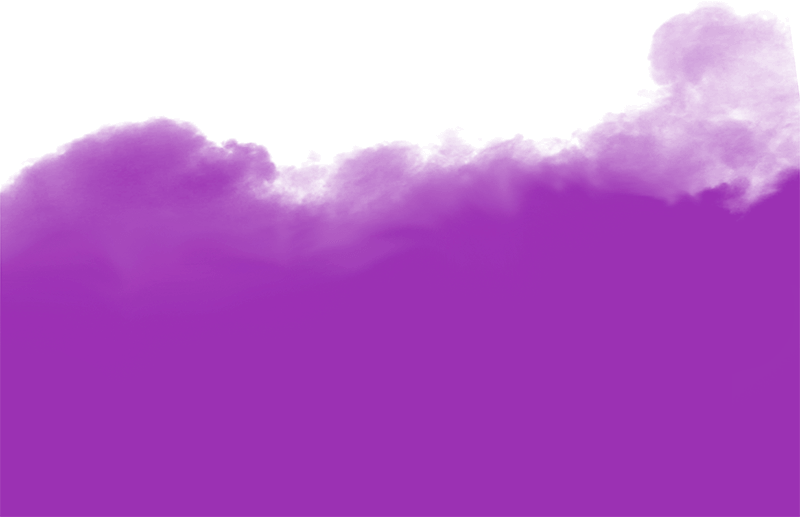
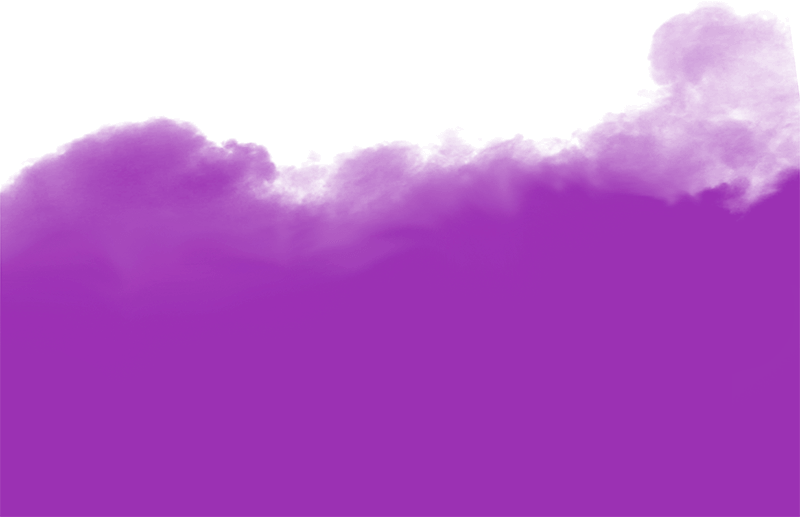
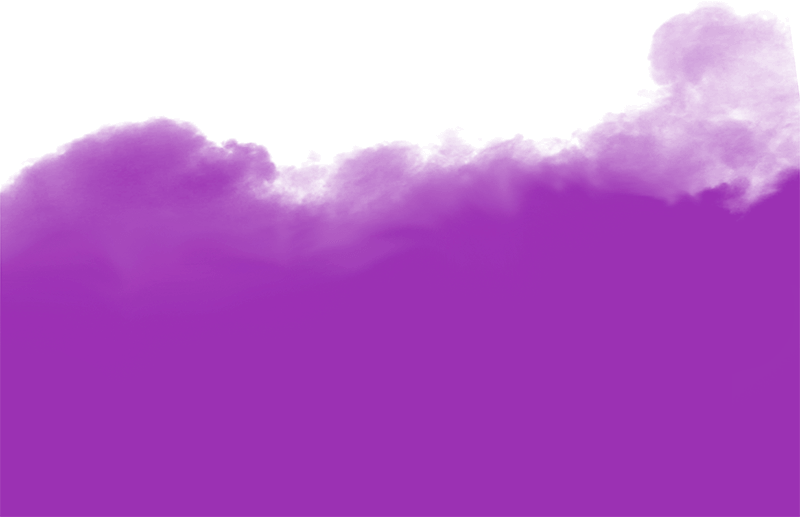
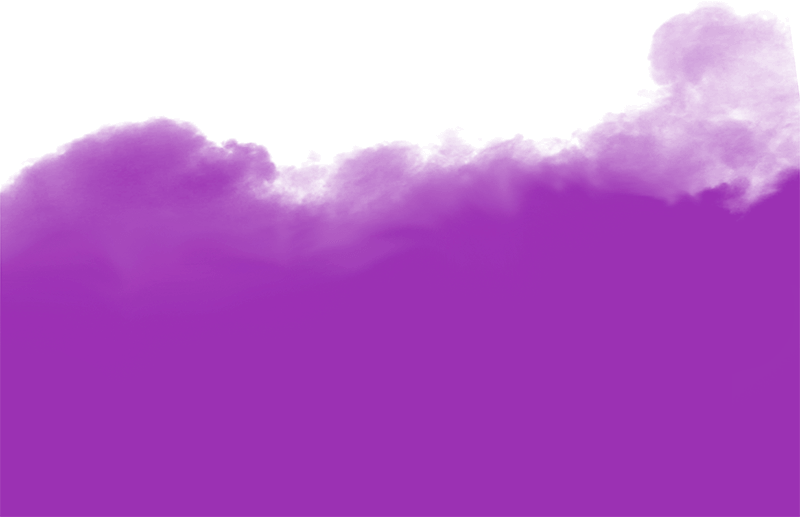
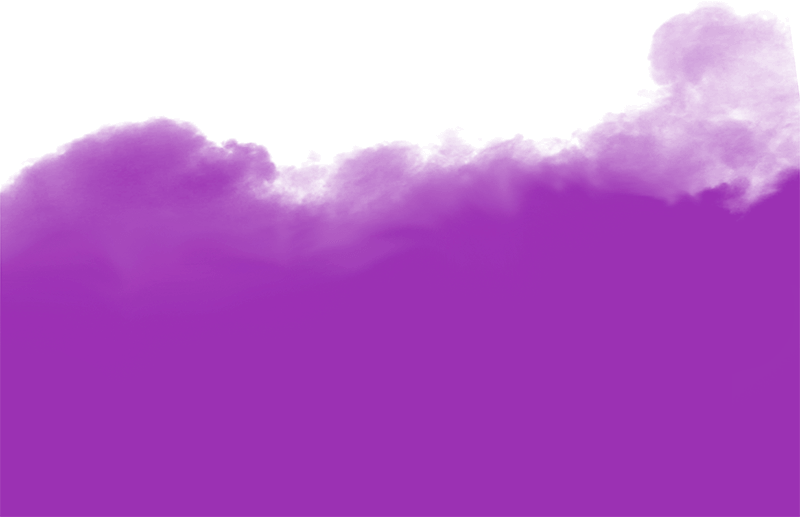
...
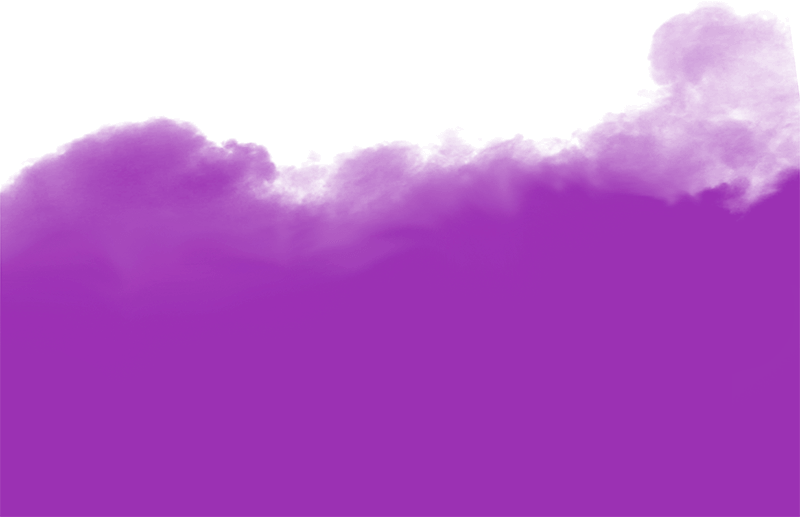
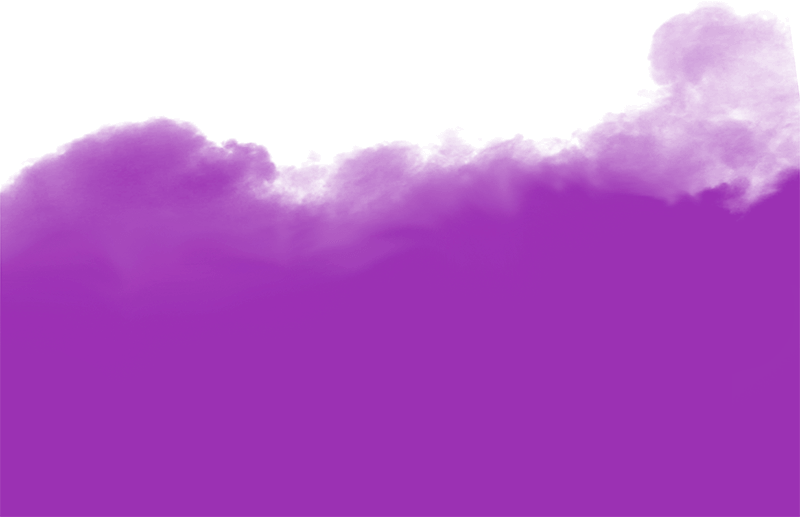
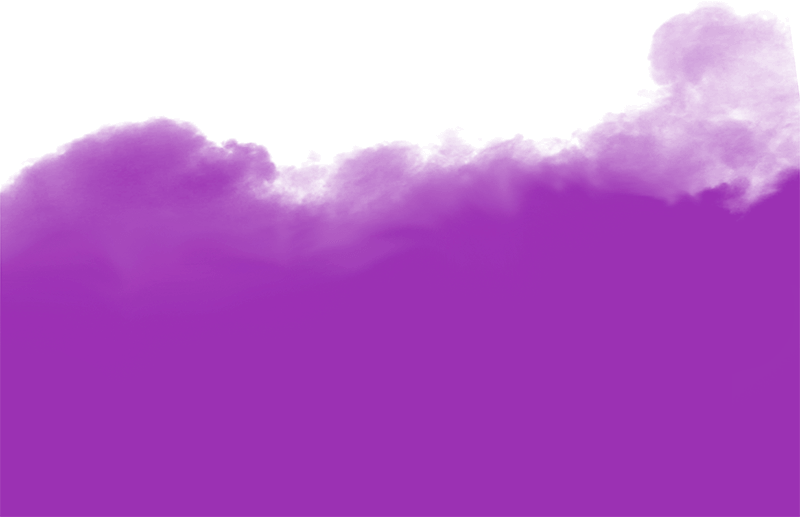
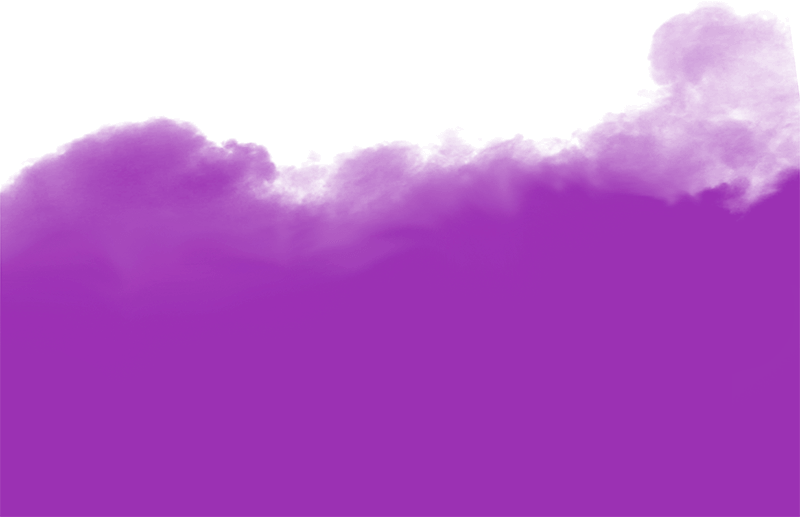
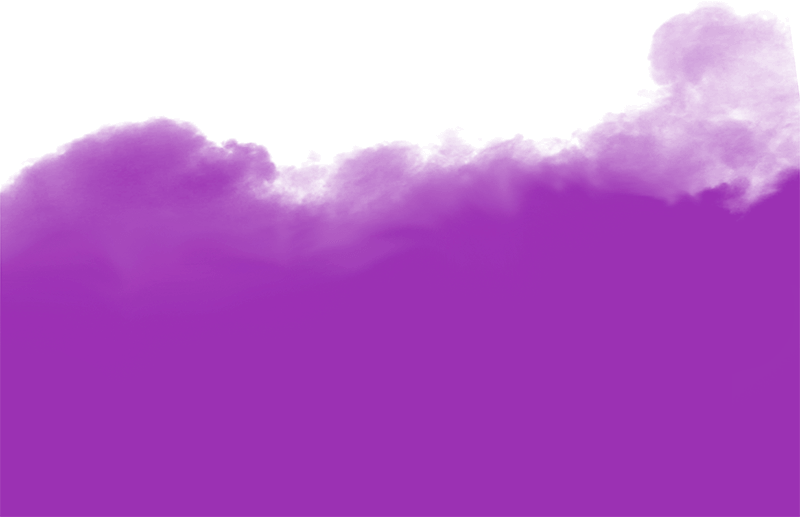

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



<!DOCTYPE html>
<html class="no-js" data-root="" data-version="klecko-" lang="en">
 <head id="suppress_all_ads">
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <title>
    Rate Limited Request (429 error) | Sports-Reference.com
   </title>
   <link href="https://www.sports-reference.com/429.html" rel="canonical"/>
   <!-- CSS start -->
   <style>
    body,html{color:#000;font:14px/1.25 Helvetica Neue,helvetica,arial,sans-serif;margin:0;padding:0}html:not(.backstop){scroll-behavior:smooth}html:not(.backstop) div,html:not(.backstop) span{scroll-snap-margin:2.5em 0 0 0;scroll-margin:2.5em 0 0 0}body{-webkit-text-size-adjust:none;-moz-text-size-adjust:none;-ms-text-size-adjust:none;background:#c9cbcd;position:relative;z-index:0}a img{border:0}li,ol,ul{list-style-type:none;margin:0;padding:0}table td,table th{border:0}iframe{max-width:100%}code{background:#eee}a
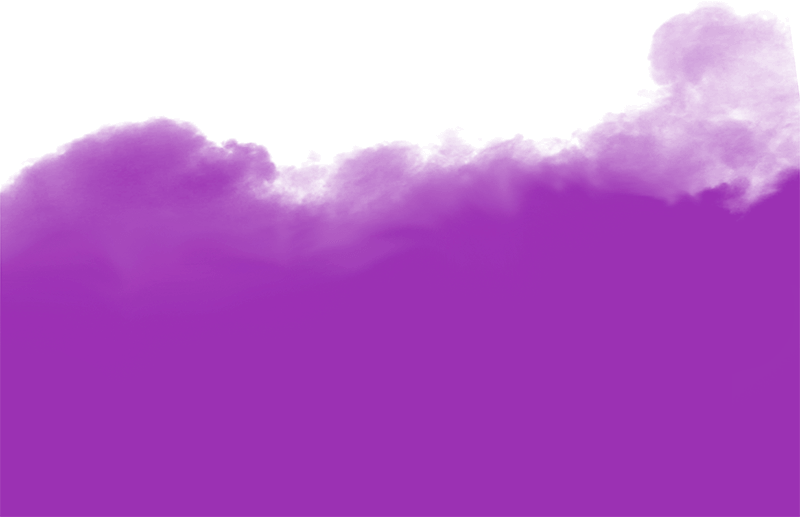
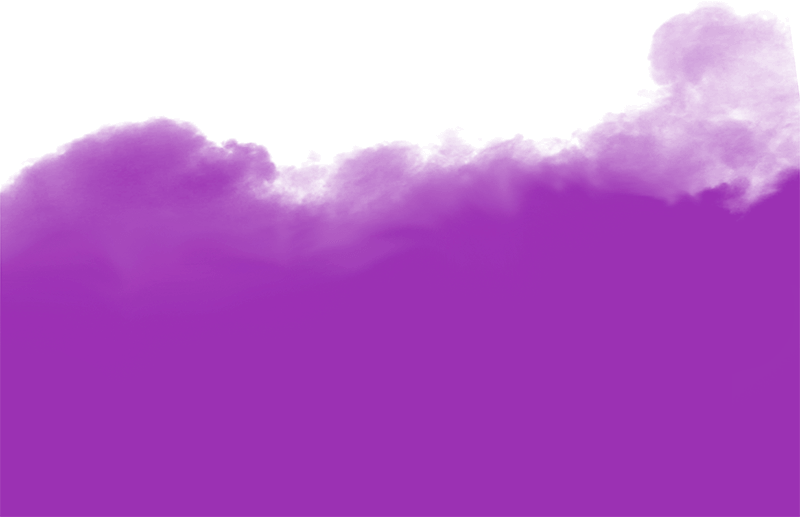
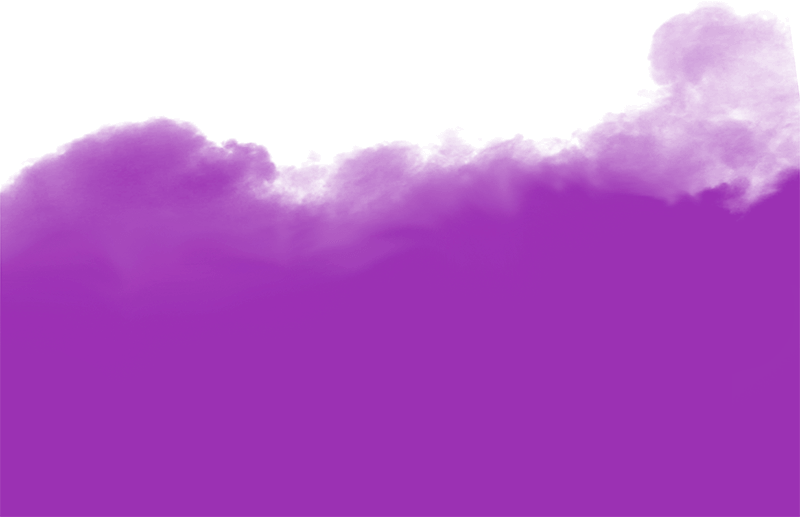
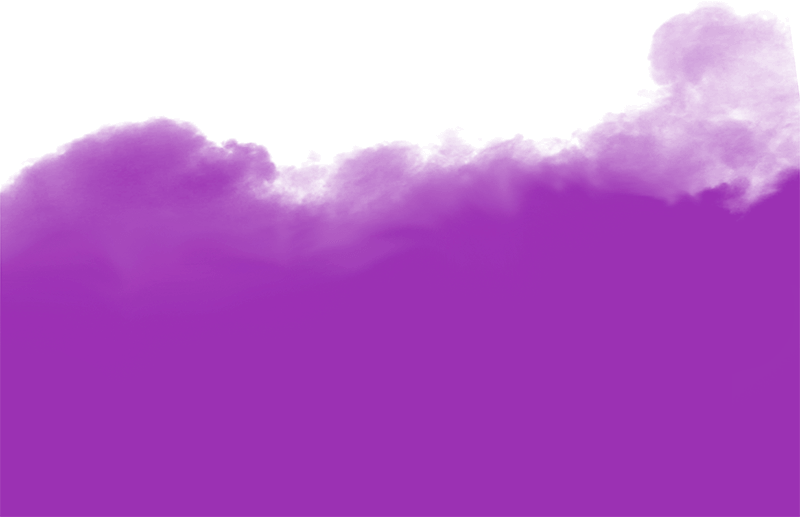
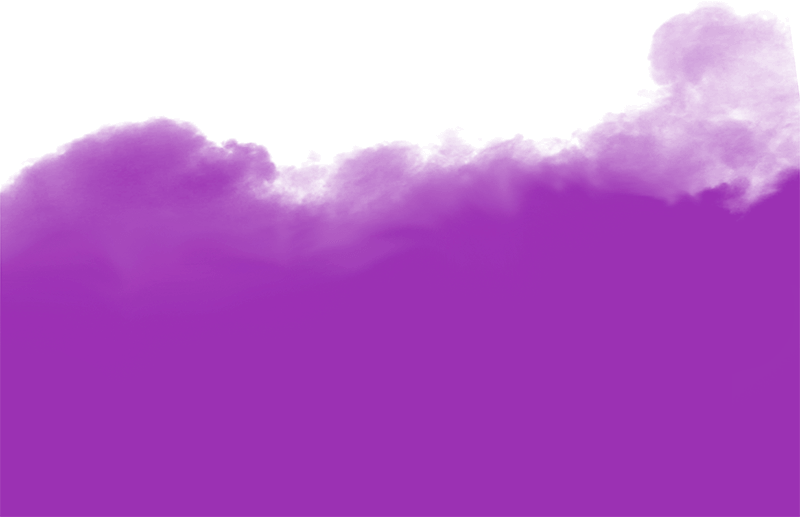
...
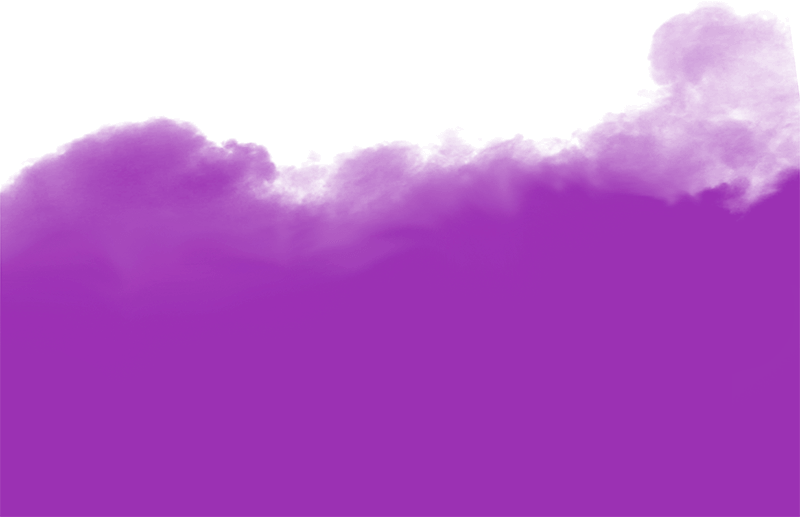
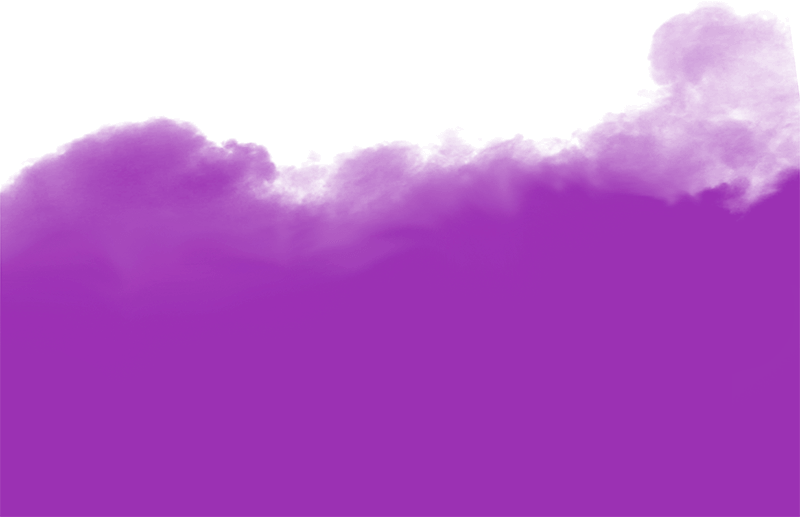
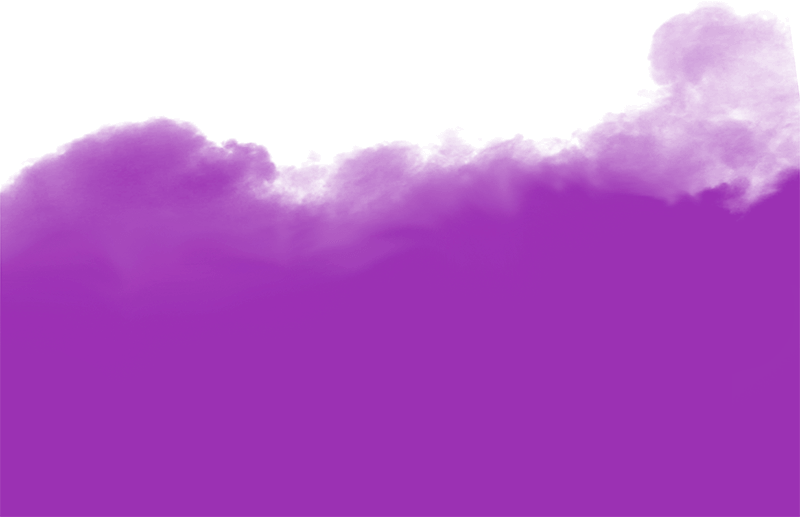
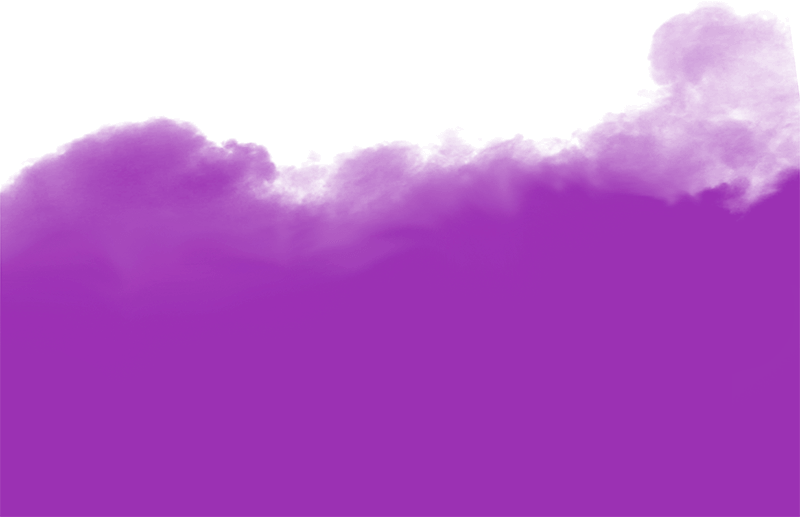
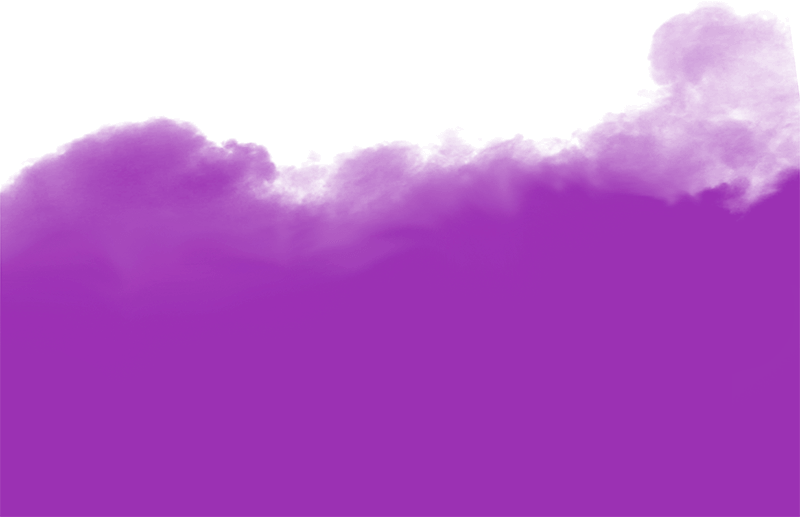

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



<!DOCTYPE html>
<html class="no-js" data-root="" data-version="klecko-" lang="en">
 <head id="suppress_all_ads">
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <title>
    Rate Limited Request (429 error) | Sports-Reference.com
   </title>
   <link href="https://www.sports-reference.com/429.html" rel="canonical"/>
   <!-- CSS start -->
   <style>
    body,html{color:#000;font:14px/1.25 Helvetica Neue,helvetica,arial,sans-serif;margin:0;padding:0}html:not(.backstop){scroll-behavior:smooth}html:not(.backstop) div,html:not(.backstop) span{scroll-snap-margin:2.5em 0 0 0;scroll-margin:2.5em 0 0 0}body{-webkit-text-size-adjust:none;-moz-text-size-adjust:none;-ms-text-size-adjust:none;background:#c9cbcd;position:relative;z-index:0}a img{border:0}li,ol,ul{list-style-type:none;margin:0;padding:0}table td,table th{border:0}iframe{max-width:100%}code{background:#eee}a
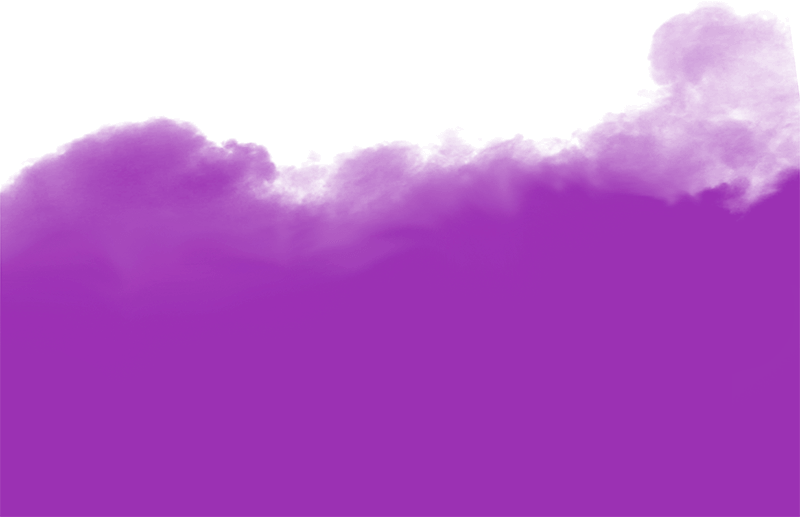
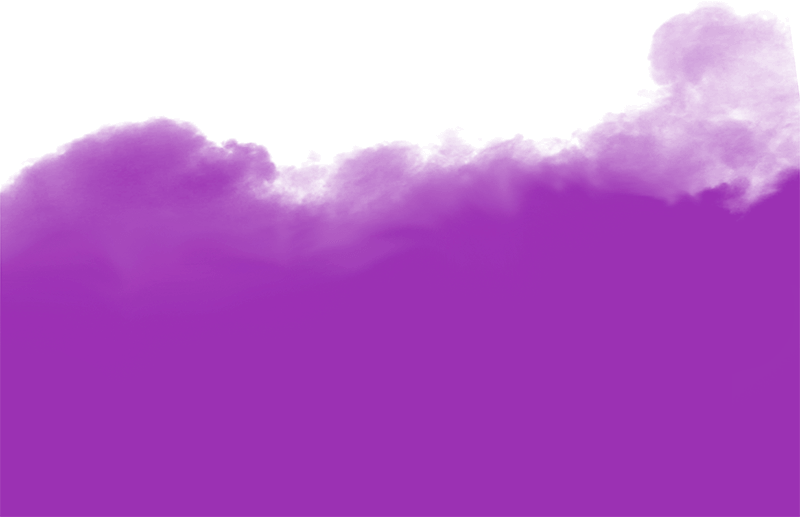
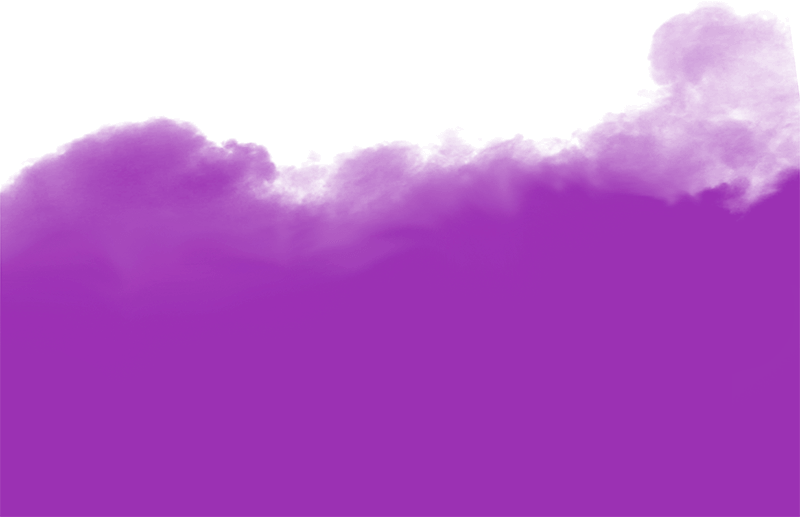
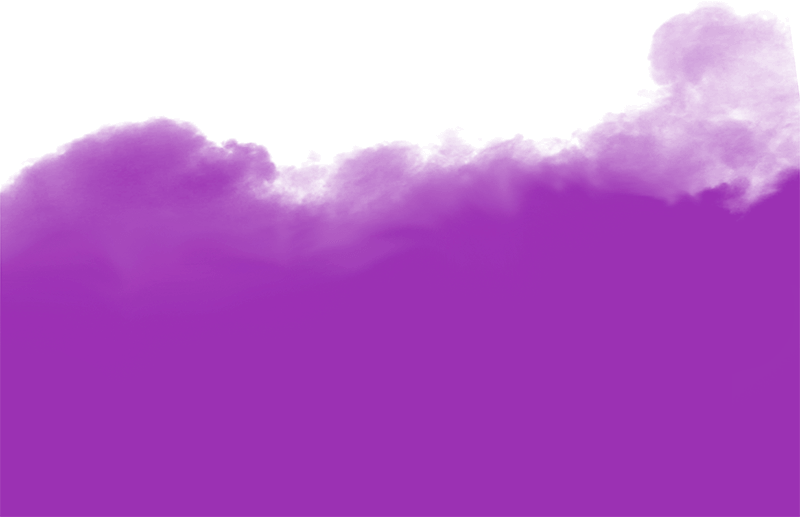
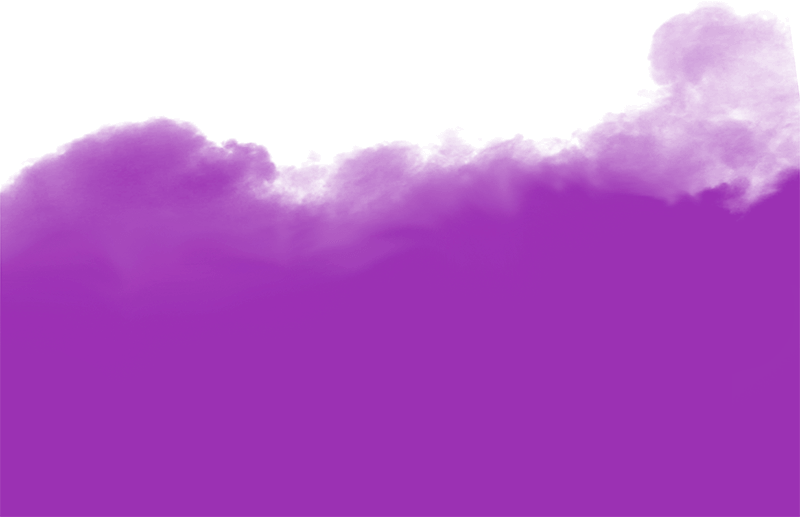
...
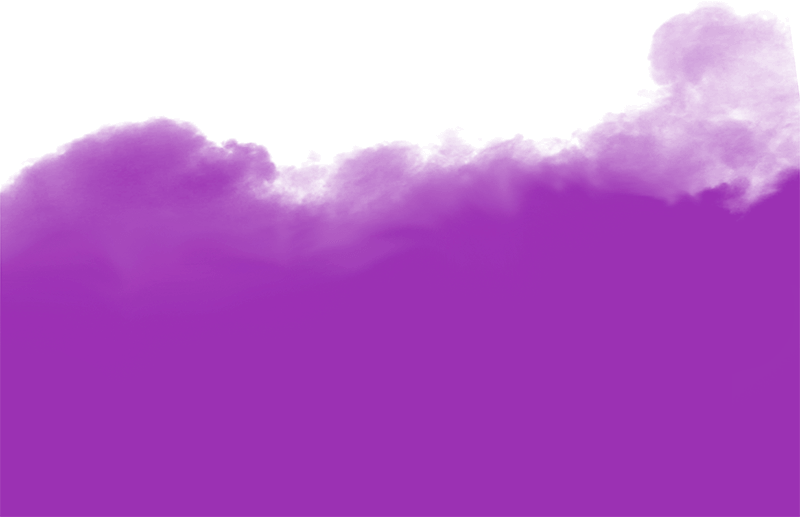
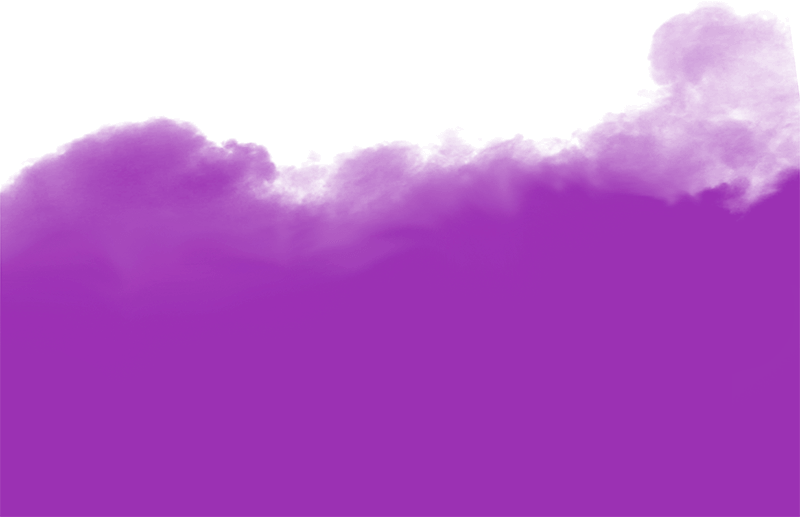
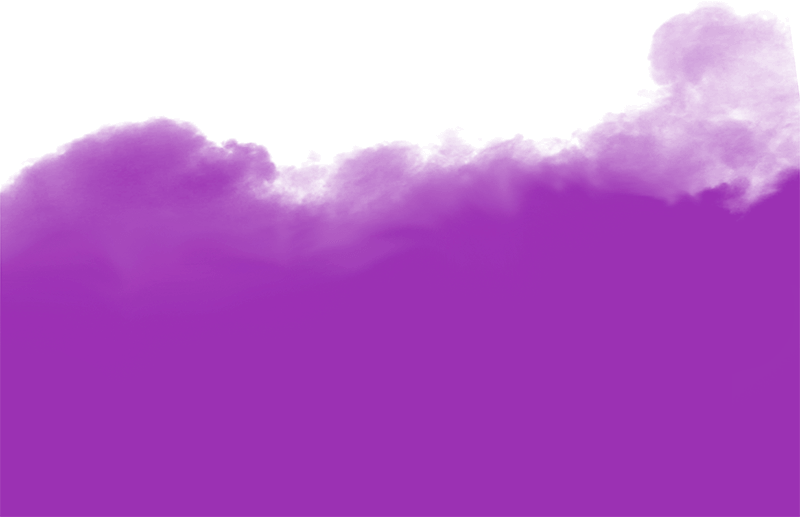
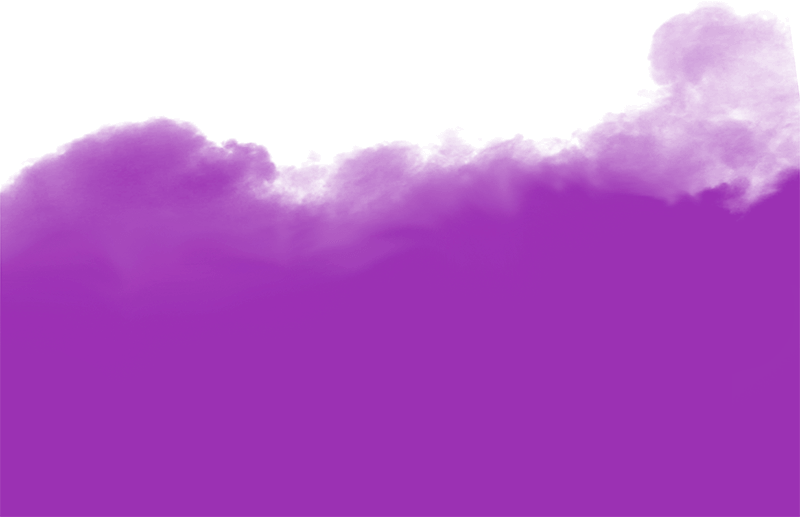
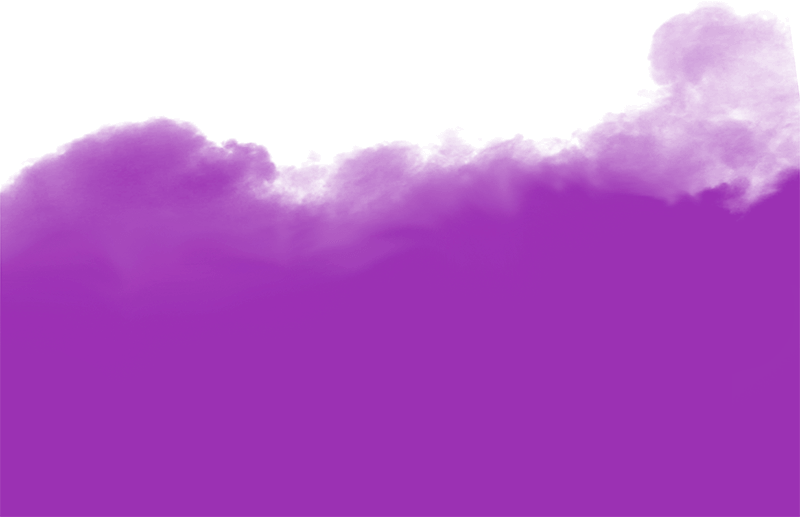

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



<!DOCTYPE html>
<html class="no-js" data-root="" data-version="klecko-" lang="en">
 <head id="suppress_all_ads">
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <title>
    Rate Limited Request (429 error) | Sports-Reference.com
   </title>
   <link href="https://www.sports-reference.com/429.html" rel="canonical"/>
   <!-- CSS start -->
   <style>
    body,html{color:#000;font:14px/1.25 Helvetica Neue,helvetica,arial,sans-serif;margin:0;padding:0}html:not(.backstop){scroll-behavior:smooth}html:not(.backstop) div,html:not(.backstop) span{scroll-snap-margin:2.5em 0 0 0;scroll-margin:2.5em 0 0 0}body{-webkit-text-size-adjust:none;-moz-text-size-adjust:none;-ms-text-size-adjust:none;background:#c9cbcd;position:relative;z-index:0}a img{border:0}li,ol,ul{list-style-type:none;margin:0;padding:0}table td,table th{border:0}iframe{max-width:100%}code{background:#eee}a
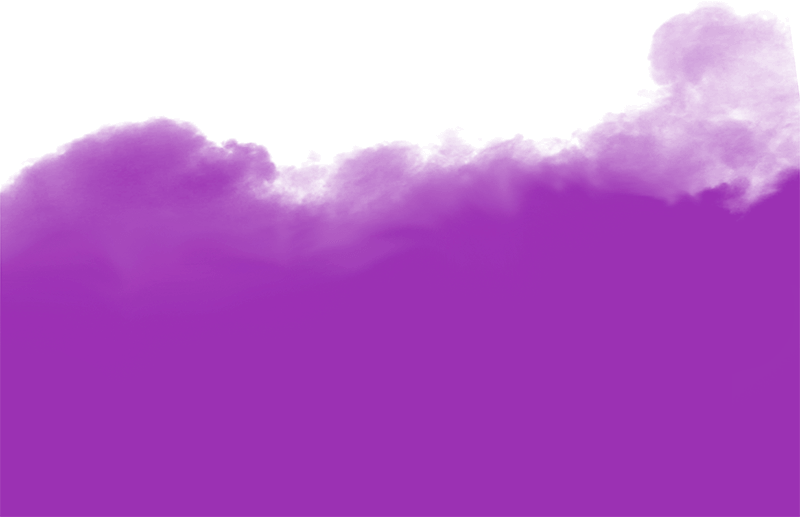
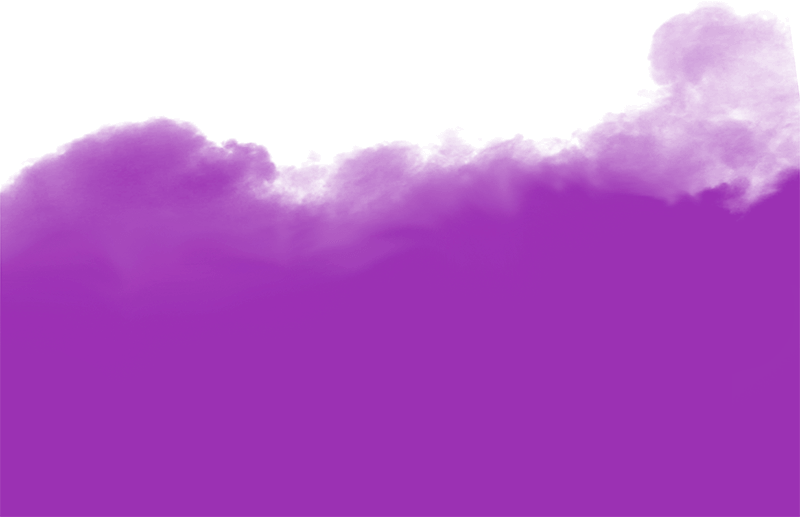
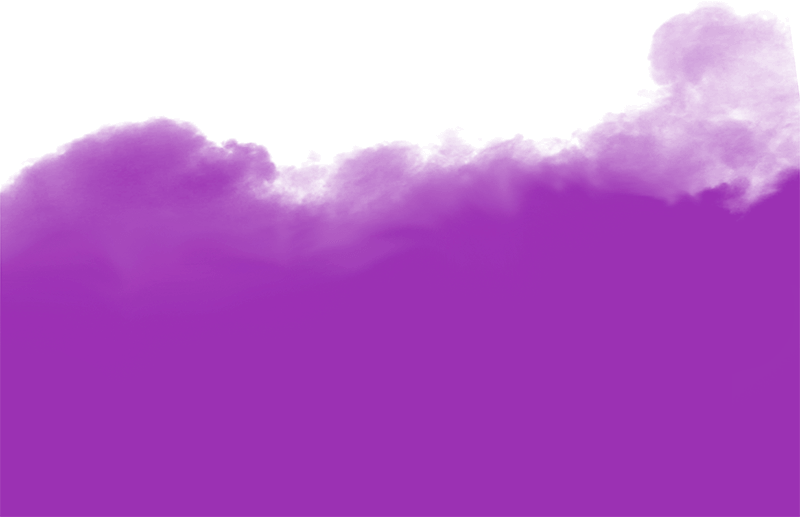
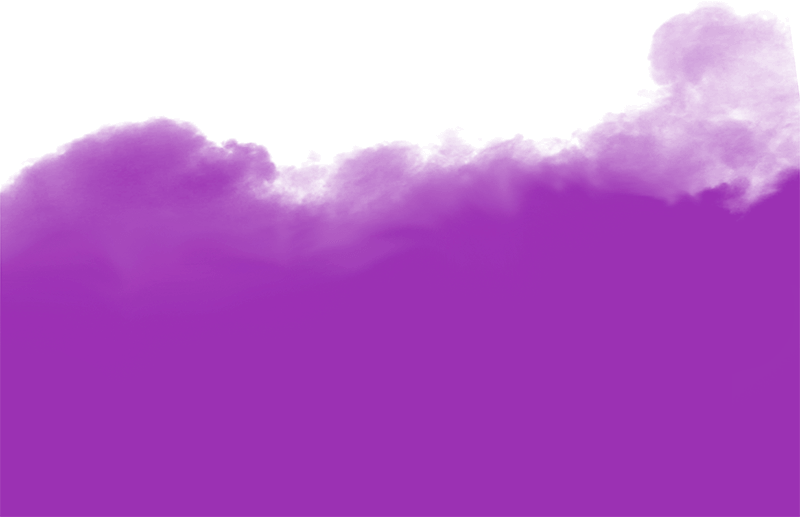
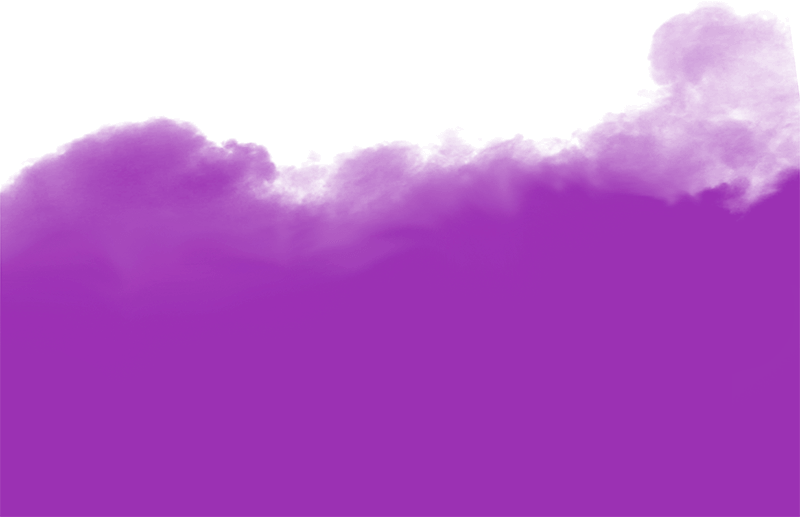
...
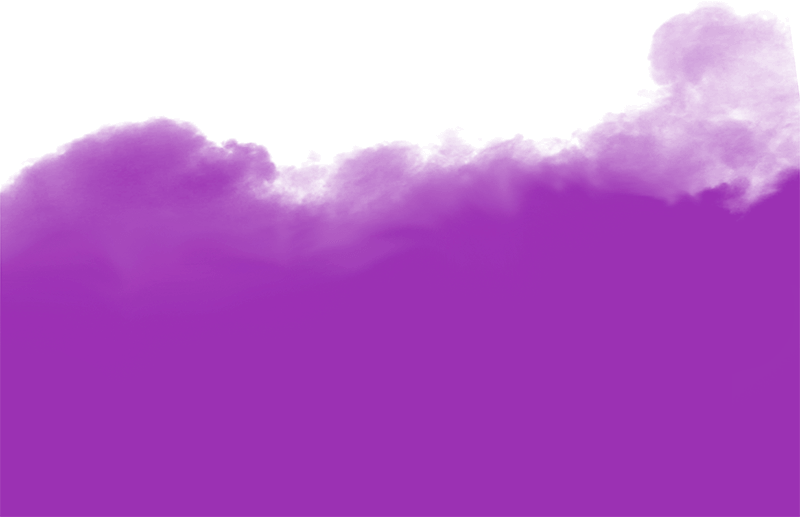
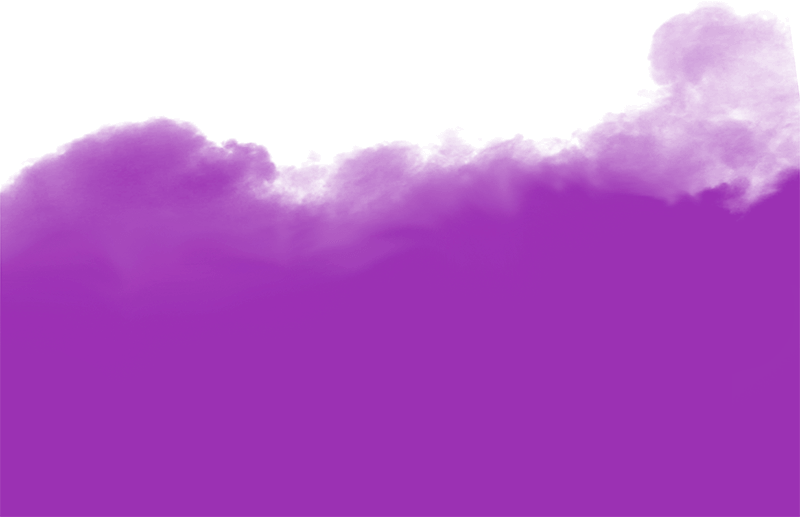
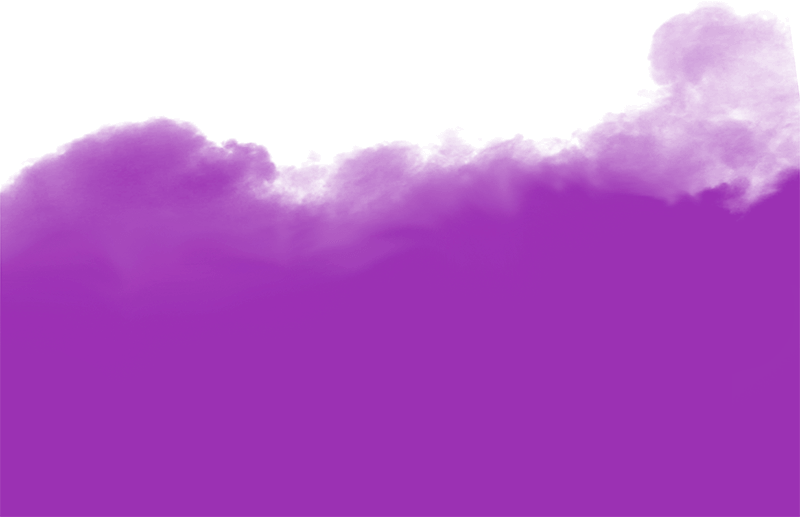
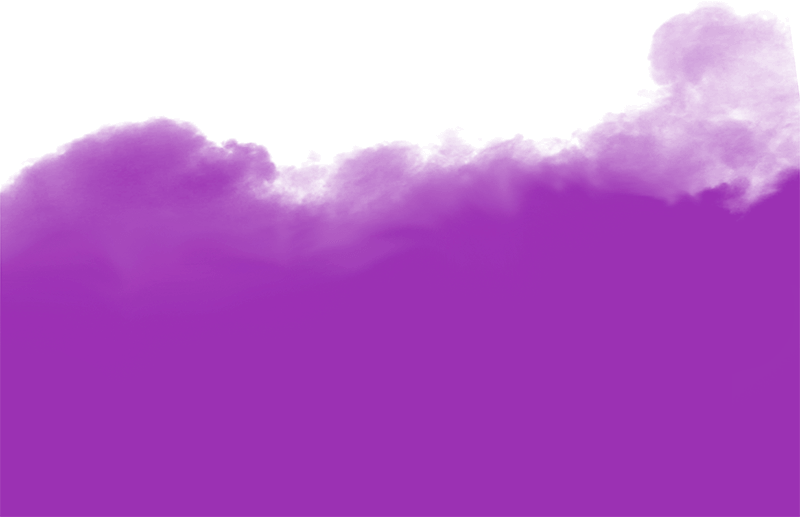
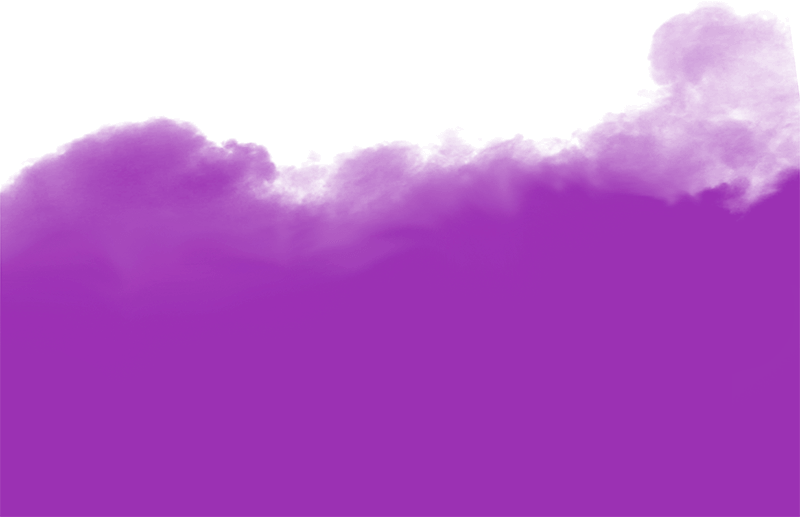

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



<!DOCTYPE html>
<html class="no-js" data-root="" data-version="klecko-" lang="en">
 <head id="suppress_all_ads">
  <meta charset="utf-8"/>
  <meta content="ie=edge" http-equiv="x-ua-compatible"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
   <title>
    Rate Limited Request (429 error) | Sports-Reference.com
   </title>
   <link href="https://www.sports-reference.com/429.html" rel="canonical"/>
   <!-- CSS start -->
   <style>
    body,html{color:#000;font:14px/1.25 Helvetica Neue,helvetica,arial,sans-serif;margin:0;padding:0}html:not(.backstop){scroll-behavior:smooth}html:not(.backstop) div,html:not(.backstop) span{scroll-snap-margin:2.5em 0 0 0;scroll-margin:2.5em 0 0 0}body{-webkit-text-size-adjust:none;-moz-text-size-adjust:none;-ms-text-size-adjust:none;background:#c9cbcd;position:relative;z-index:0}a img{border:0}li,ol,ul{list-style-type:none;margin:0;padding:0}table td,table th{border:0}iframe{max-width:100%}code{background:#eee}a
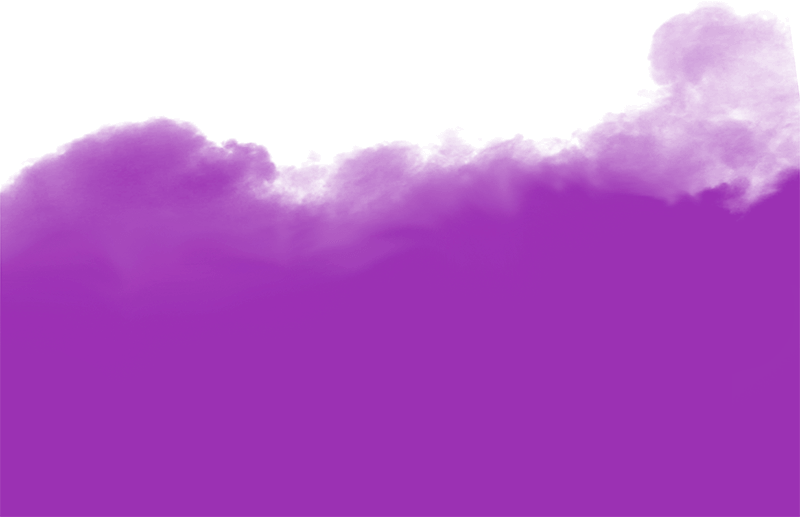
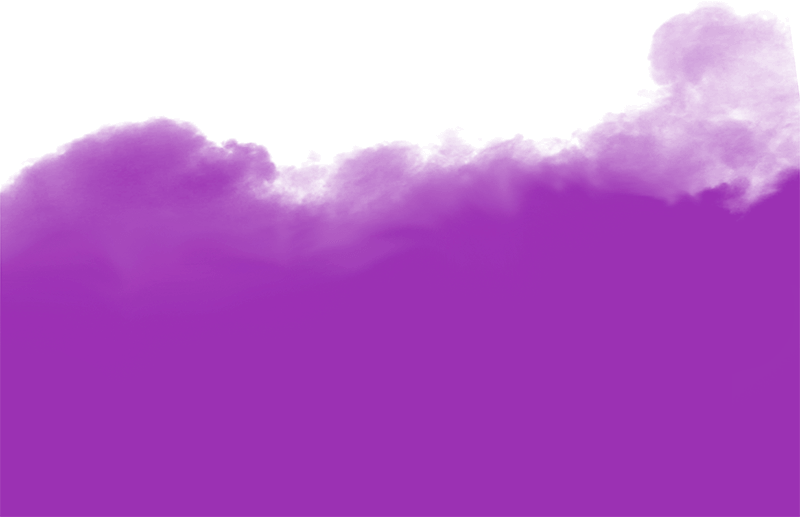
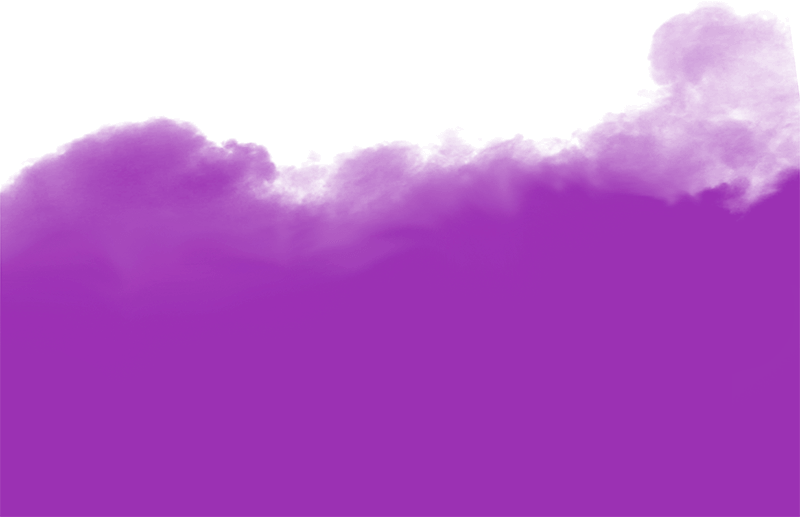
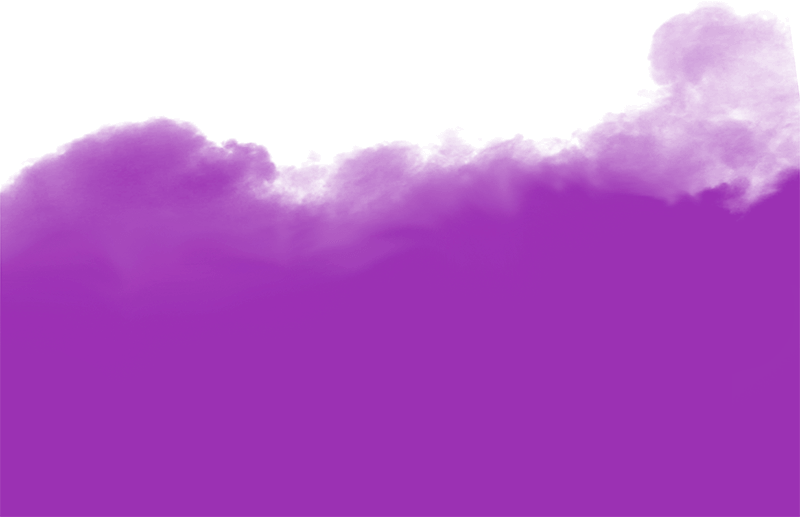
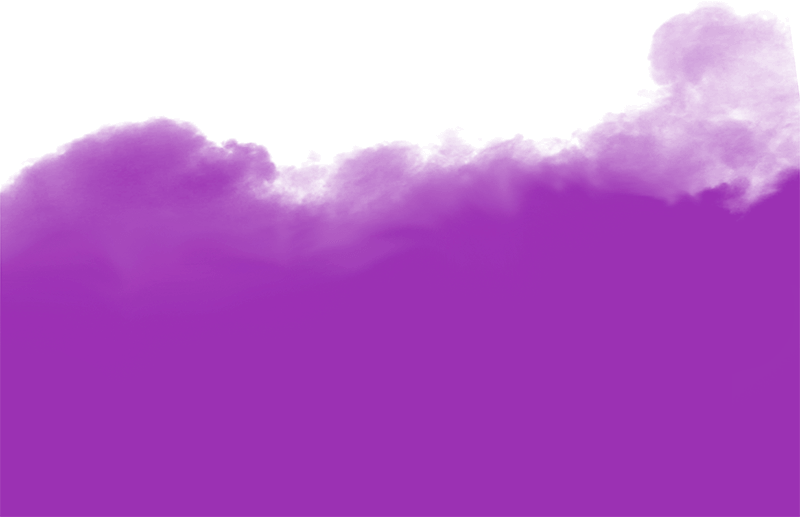
...
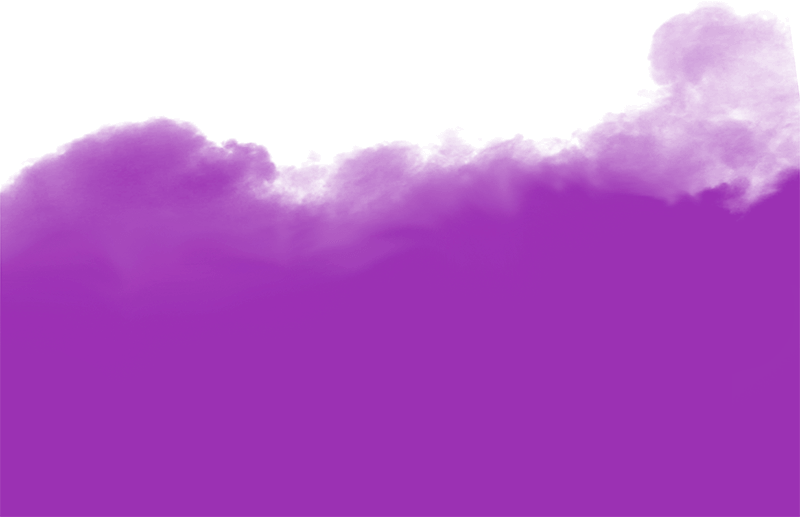
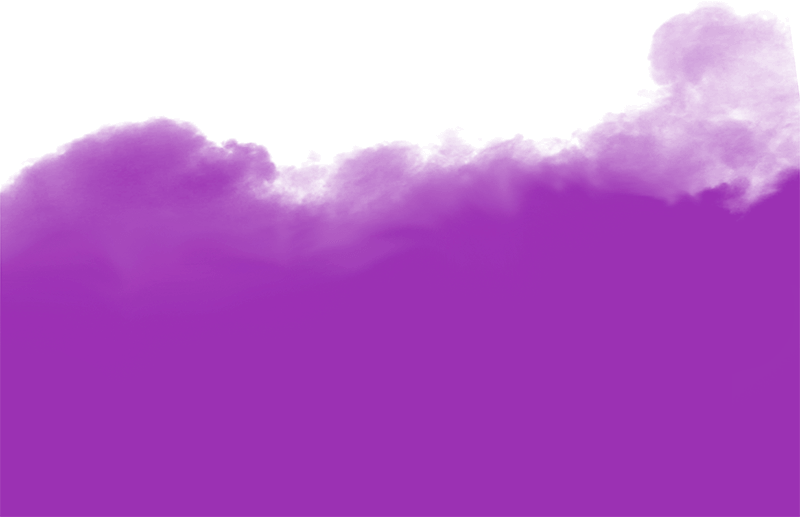
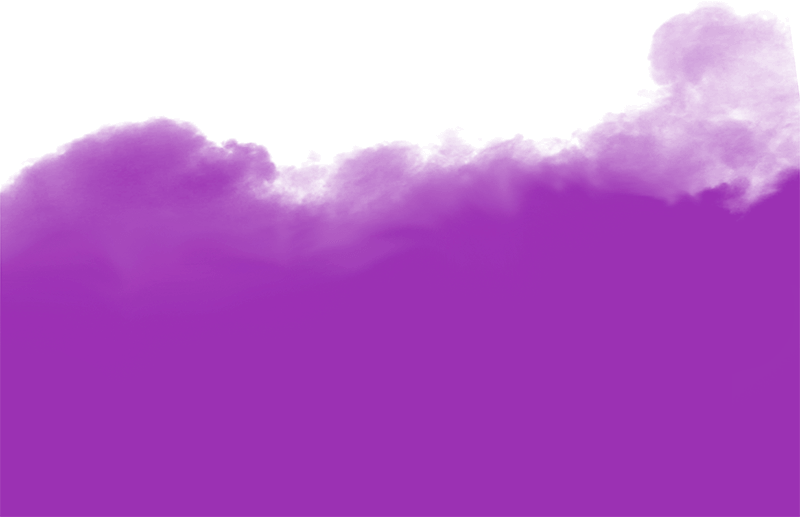
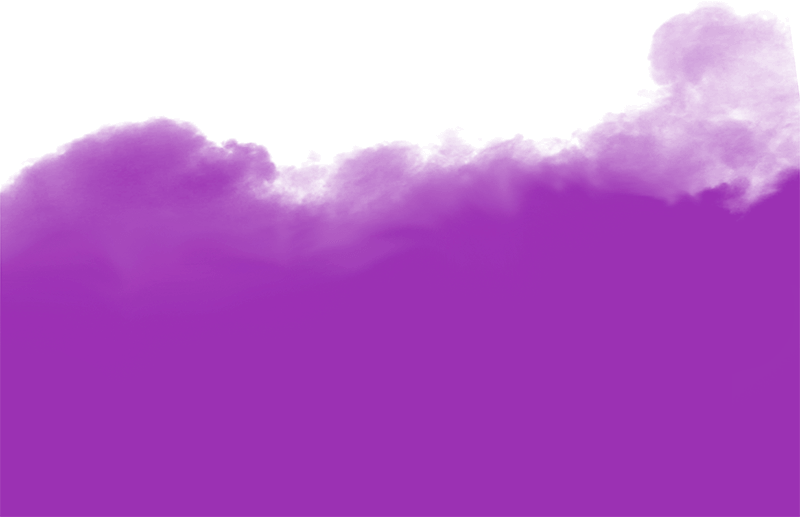
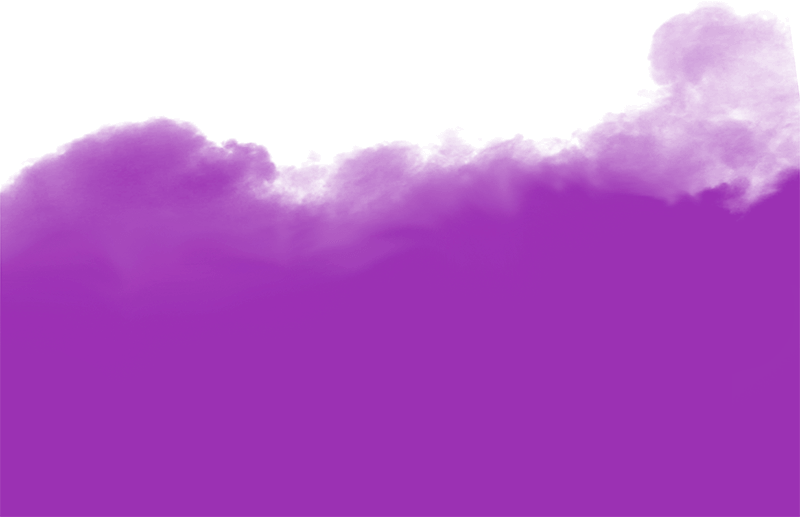

KeyboardInterrupt: 

In [20]:

soup = BeautifulSoup(response.text, 'html.parser')
list_of_draft_picks = soup.find('tbody').find_all('tr')

for player in list_of_draft_picks:
    player_values = player.contents
    new_url = ""
    player_obj = {}
    for value in player_values:
        # print(type(value))
        ## Validate Position is a QB, if it isn't continue
        if type(value) is not element.NavigableString:
            if value['data-stat'] == "pos":
                if value.get_text() != "QB":
                    continue
        ## Get the new link for parsing game by game data
            if value['data-stat'] == "player":
                secondary_link = value.find("a")
                if secondary_link is None:
                    continue
                elif "href" not in secondary_link.attrs:
                    continue
                    
                new_url = f"{base_url}{value.find("a")["href"]}" 
                get_player_html_data(new_url)
                break
    
## Write to html file because Prettify has a lot of data
with open('output.html', 'w', encoding='utf-8') as file:
    file.write(soup.find('tbody').prettify())